In [1]:
%matplotlib inline

In [2]:
!pip install cityseer

In [3]:
import requests
import fiona
from shapely import geometry
import utm
import numpy as np
import networkx as nx
from cityseer.util import graphs
from cityseer.metrics import networks
import matplotlib.pyplot as plt
from matplotlib import colors

# Quick example

This example extracts a 20km radius around the centre of boston

In [4]:
lat, lng = (42.360081, -71.058884)
# cast the WGS coordinates to UTM prior to buffering
easting, northing, utm_zone_number, utm_zone_letter = utm.from_latlon(lat, lng)
# create a point, and then buffer
pt = geometry.Point(easting, northing)
poly_utm = pt.buffer(20000)

# Shapefile example

This workflow requires a path to your shapefile, and assumes that the shapefile is in EPSG 4326 CRS.

*i.e. this won't work until you've run the notebook from a local directory with access to this file.*

In [5]:
with fiona.open('./demo_notebooks/boston/boston_4326.shp') as src:
    for i, shape in enumerate(src):
        print(f'processing item {i}')
        multipoly = geometry.shape(shape['geometry'])

# MultiPolygon
print(f'Geometry type: {multipoly.type}')
# number of geoms = 26
print(f'Number of geometries: {len(multipoly.geoms)}')
# largest poly is not valid...
print(f'Geometry validity: {multipoly.is_valid}')

# convert to UTM
geoms = []
utm_zone_number = utm_zone_letter = None
for geom in multipoly.geoms:
    if utm_zone_number is None:
        lng, lat = geom.exterior.coords[0]
        easting, northing, utm_zone_number, utm_zone_letter = utm.from_latlon(lat, lng)
    geom_utm = [utm.from_latlon(lat, lng)[:2] for lng, lat in geom.exterior.coords]
    geom_utm = geometry.Polygon(geom_utm)
    geoms.append(geom_utm)
multipoly_utm = geometry.MultiPolygon(geoms)

# try fix validity
print(f'UTM geometry validity: {multipoly_utm.is_valid}')
# still not valid, so try buffer and erosion
poly_utm = multipoly_utm.buffer(10000).buffer(-10000)
# is now polygon
print(f'UTM geometry type: {poly_utm.type}')
# now valid
print(f'UTM geometry validity: {poly_utm.is_valid}')
print(f'UTM geometry area: {poly_utm.area}')
print(f'UTM geometry width: {poly_utm.bounds[2] - poly_utm.bounds[0]}')

ERROR:fiona._env:./demo_notebooks/boston/boston_4326.shp: No such file or directory


DriverError: ./demo_notebooks/boston/boston_4326.shp: No such file or directory

Convert back to WGS and make the request

*Edit the `highway` filtering as required, here `footway` is excluded as this can introduce a lot of oddities...*

In [5]:
# in some cases the polygon geometry may be too big for the OSM server
# thus use of convex hull instead of actual polygon geometry
geom = [utm.to_latlon(east, north, utm_zone_number, utm_zone_letter) for east, north in poly_utm.convex_hull.exterior.coords]
poly_wgs = geometry.Polygon(geom)

# format for OSM query
geom_osm = str.join(' ', [f'{lat} {lng}' for lat, lng in poly_wgs.exterior.coords])

# osm query
timeout = 60 * 10  # 10 minutes
filters = '["area"!~"yes"]' \
          '["highway"!~"footway|proposed|construction|abandoned|platform|raceway|service"]' \
          '["foot"!~"no"]' \
          '["service"!~"private"]' \
          '["access"!~"private"]'
query = f'[out:json][timeout:{timeout}];(way["highway"]{filters}(poly:"{geom_osm}"); >;);out skel qt;'
try:
    response = requests.get('https://overpass-api.de/api/interpreter',
                            timeout=timeout,
                            params={
                                'data': query
                            })
except requests.exceptions.RequestException as e:
    raise e

Load the OSM response data into a networkX graph

In [6]:
G_wgs = graphs.nX_from_osm(osm_json=response.text)
print(nx.info(G_wgs))

Name: 
Type: Graph
Number of nodes: 479613
Number of edges: 502451
Average degree:   2.0952


Cast the graph to UTM coordinates prior to processing

In [9]:
G_utm = graphs.nX_wgs_to_utm(G_wgs)

INFO:cityseer.util.graphs:Converting networkX graph from WGS to UTM.
INFO:cityseer.util.graphs:Processing node x, y coordinates.


INFO:cityseer.util.graphs:Processing edge geom coordinates, if present.


Setup a plotting function.

Here we'll create a 3km buffer (i.e. we're zooming-in) to make it easier to see inner Boston

In [10]:
# take centrepoint
lng, lat = (-71.058884, 42.360081)
# convert to UTM using same UTM as before
easting, northing = utm.from_latlon(lat, lng, force_zone_letter=utm_zone_letter, force_zone_number=utm_zone_number)[:2]
# buffer
buff = geometry.Point(easting, northing).buffer(3000)
# extract extents
min_x, min_y, max_x, max_y = buff.bounds
print(f'min x: {min_x:.1f} min y: {min_y:.1f} max x: {max_x:.1f} max y: {max_y:.1f}')
# min x: 327449.4 min y: 4688809.9 max x: 333449.4 max y: 4694809.9

def nx_plot_zoom(nx_graph,
                 x_lim=(min_x, max_x),
                 y_lim=(min_y, max_y),
                 figsize=(20, 20),
                 dpi=200,
                 colour=None,
                 **kwargs):
    # cleanup old plots
    plt.ioff()
    plt.close('all')
    plt.cla()
    plt.clf()
    # create new plot
    plt.figure(figsize=figsize, dpi=dpi, **kwargs)
    # extract x, y
    pos = {}
    for n, d in nx_graph.nodes(data=True):
        pos[n] = (d['x'], d['y'])
    # default node colour if needed
    if colour is None:
        colour = '#d32f2f'
    nx.draw(nx_graph,
            pos,
            with_labels=False,
            node_color=colour,
            node_size=30,
            node_shape='o',
            edge_color='b',
            width=1,
            alpha=0.75)
    # override face color if necessary
    plt.gcf().set_facecolor('#fff')
    # extract limits
    plt.xlim(*x_lim)
    plt.ylim(*y_lim)
    # show
    plt.show()
    
nx_plot_zoom(G_utm)

min x: 327449.4 min y: 4688809.9 max x: 333449.4 max y: 4694809.9


INFO:cityseer.util.graphs:Generating simple (straight) edge geometries.


INFO:cityseer.util.graphs:Removing dangling nodes.


INFO:cityseer.util.graphs:Removing filler nodes.


<Figure size 432x288 with 0 Axes>

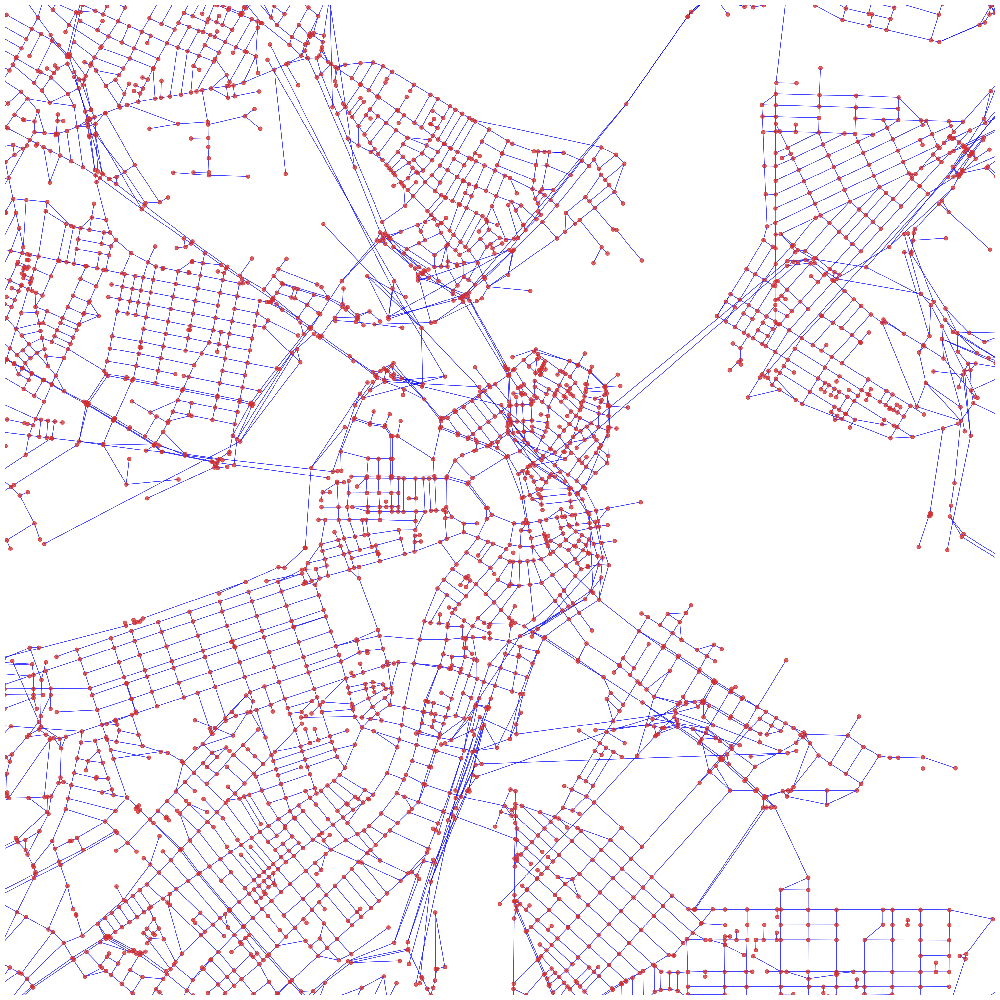

In [14]:
G = graphs.nX_simple_geoms(G_utm)
G = graphs.nX_remove_dangling_nodes(G, despine=25, remove_disconnected=True)
G = graphs.nX_remove_filler_nodes(G)
nx_plot_zoom(G)

Spatial consolidation using the parallel method

INFO:cityseer.util.graphs:Consolidating network by parallel edges.


<Figure size 432x288 with 0 Axes>

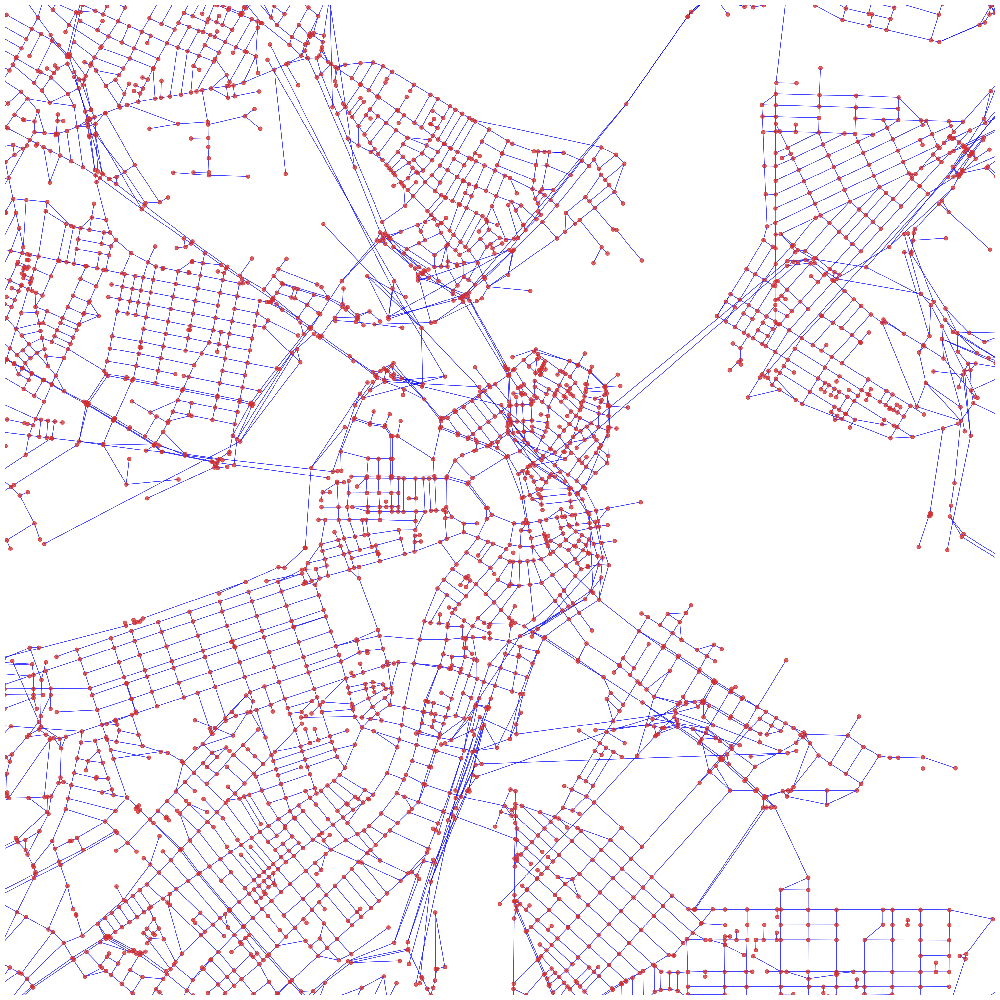

In [15]:
G_cons = graphs.nX_consolidate_parallel(G, buffer_dist=15)
nx_plot_zoom(G)

Optional decomposition

INFO:cityseer.util.graphs:Decomposing graph to maximum edge lengths of 100.


<Figure size 432x288 with 0 Axes>

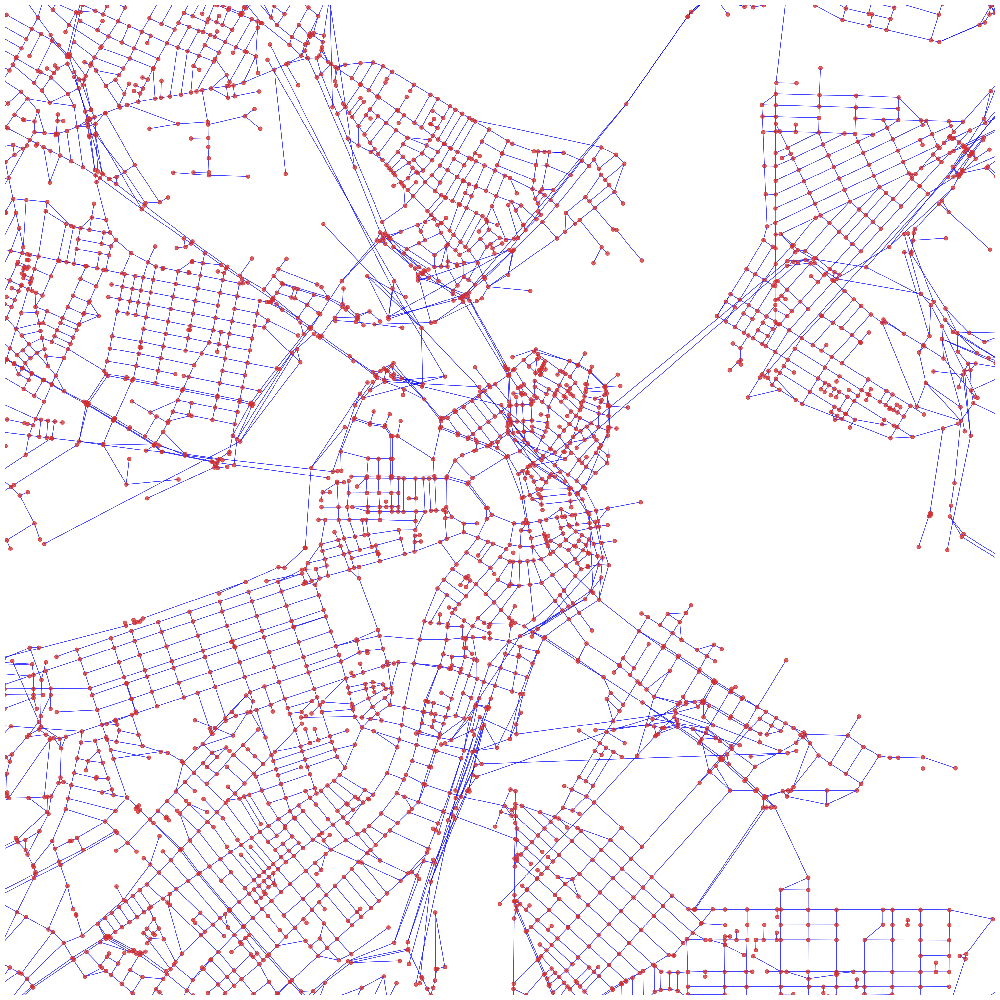

In [16]:
G_cons = graphs.nX_decompose(G_cons, decompose_max=100)
nx_plot_zoom(G)

Create a Network layer from the networkX graph, then run the analysis.

This will run faster on a local computer.

*Keep in mind that the larger the distance the slower it will run. These algos have not been optimised for global methods.*

In [17]:
N = networks.Network_Layer_From_nX(G_cons, distances=[400, 800, 1600])
# the underlying method allows the computation of various centralities simultaneously, e.g.
N.compute_centrality(measures=['node_harmonic'])

INFO:cityseer.util.graphs:Preparing node and edge arrays from networkX graph.
INFO:cityseer.util.graphs:Preparing graph


INFO:cityseer.util.graphs:Generating data arrays


INFO:cityseer.metrics.networks:Computing node_harmonic centrality measures using shortest (non-angular) path heuristic.


|           | 0.0 %
|           | 9.09 %
|#          | 18.18 %
|##         | 27.27 %
|###        | 36.36 %
|####       | 45.45 %
|#####      | 54.54 %
|######     | 63.63 %
|#######    | 72.72 %
|#########  | 81.82 %
|########## | 90.91 %
|###########| 100.0 %
|###########| 100 %


Convert back to networkX after analysis has been completed

In [18]:
G_metrics = N.to_networkX()

INFO:cityseer.util.graphs:Populating node and edge map data to a networkX graph.
INFO:cityseer.util.graphs:Reusing existing graph as backbone.
INFO:cityseer.util.graphs:Unpacking node data.


INFO:cityseer.util.graphs:Unpacking edge data.


INFO:cityseer.util.graphs:Unpacking metrics to nodes.


Then plot

<Figure size 432x288 with 0 Axes>

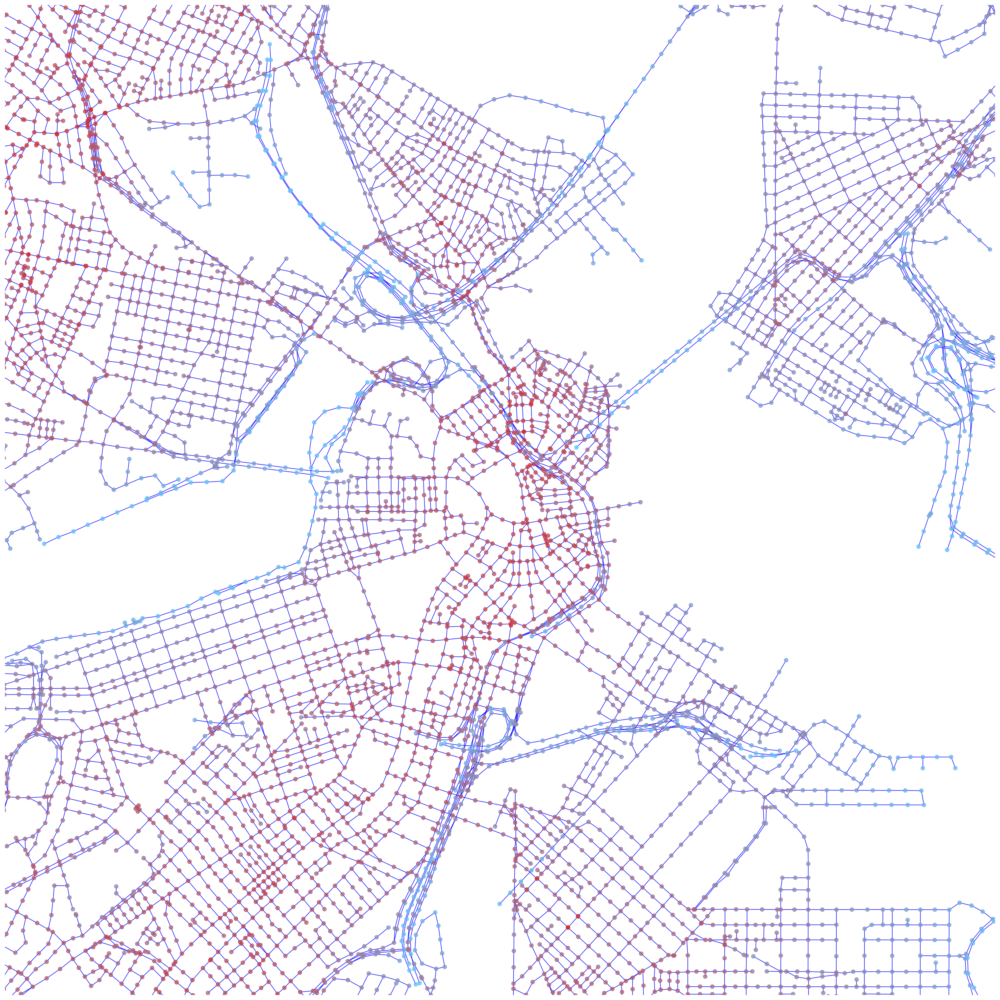

In [19]:
# plot centrality
harmonic_closeness = []
for node, data in G_metrics.nodes(data=True):
    harmonic_closeness.append(data['metrics']['centrality']['node_harmonic'][1600])
# custom colourmap
cmap = colors.LinearSegmentedColormap.from_list('cityseer', ['#64c1ff', '#d32f2f'])
# mask outliers
harmonic_closeness = np.array(harmonic_closeness)
upper_threshold = np.percentile(harmonic_closeness, 99.9)
outlier_idx = harmonic_closeness > upper_threshold
harmonic_closeness[outlier_idx] = upper_threshold
# normalise the values
segment_harmonic_vals = colors.Normalize()(harmonic_closeness)
# cast against the colour map
segment_harmonic_cols = cmap(segment_harmonic_vals)
# plot
nx_plot_zoom(G_cons, colour=segment_harmonic_cols)